## Prochoice vs Prolife : 트위터 텍스트 데이터 감정 분석

https://www.kaggle.com/code/vencerlanz09/tweets-eda-sentiment-analysis/notebook

- Pro-choice and Pro-life : 낙태 합법화에 대한 입장에 대한 집단 분류

    - `pro-choice (선택 찬성)` : **낙태 합법화를 옹호하는 사람들**로, 누구나 선택할 권리가 있음을 강조함. 실제로 낙태를 선택하지 않더라도, 계획하지 않은 임신을 위한 선택으로 낙태를 선택할 수 있는 능력을 가지고 있어도 괜찮다고 믿음

    - `pro-life (생명 옹호)` : **낙태 합법화를 반대하는 사람들**로, 태아는 독립된 생명체로 생명권을 가진다고 주장함. 생명의 시작을 임신과 동시에 이루어진다고 생각하며, 낙태 합법화가 사회에 부정적인 영향을 줄 수 있다고 강조함. 

- 두 집단에 대한 트위터 텍스트를 탐색적으로 분석하여 통계적인 인사이트를 얻고자 한다.

In [1]:
# Import Data Preprocessing and Wrangling libraries
import re
from tqdm.notebook import tqdm
import pandas as pd 
import numpy as np
from datetime import datetime

# Import NLP Libraries
import nltk
from spellchecker import SpellChecker
from nltk.sentiment.vader import SentimentIntensityAnalyzer as SIA

# Import Visualization Libraries
import plotly.offline as pyo 
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import seaborn as sns 
import scattertext as st
from IPython.display import IFrame
from wordcloud import WordCloud, ImageColorGenerator
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import random 

# Downloading periphrals
nltk.download('vader_lexicon')
nltk.download('stopwords')

# Remove distarcting warning
import warnings
warnings.filterwarnings('ignore')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\kms10\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\kms10\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
# Intializate our tools 
sns.set_style('darkgrid')

# For sentiment analysis
sia = SIA() 

# To identify misspelled words
spell = SpellChecker()

# To display plotly graphs 
pyo.init_notebook_mode()

# Storing csv dataset into a datframe
df = pd.read_csv("prochoice_prolife.csv").drop('Unnamed: 0', axis=1)
df

,author_id,author_name,author_username,created_at,id,public_metrics,text,retweet_count,like_count,target
0,73506221,Oregon Right to Life,OR_RTL,2022-06-23 00:00:06+00:00,1539760170900799490,"{'retweet_count': 5, 'reply_count': 0, 'like_c...",We know that unsupported pregnancies can gener...,5,13,1
1,96631851,αιяgσ*мαтι¢*σρтιχ,sacraficial,2022-06-23 00:01:14+00:00,1539760456977395712,"{'retweet_count': 0, 'reply_count': 0, 'like_c...",If you are murdered by a George W. Bush weapon...,0,0,1
2,3041829701,skb,skb37027,2022-06-23 00:04:30+00:00,1539761277702213633,"{'retweet_count': 0, 'reply_count': 0, 'like_c...",.@MarshaBlackburn so much for #ProLife. https:...,0,0,1
3,177260708,Right To Life League,Right2LifeLg,2022-06-23 00:09:50+00:00,1539762620055552001,"{'retweet_count': 6, 'reply_count': 3, 'like_c...",Follow our instagram for more posts like this!...,6,19,1
4,1523376591052582912,No Forced Birth,NoForcedBirth,2022-06-23 00:09:57+00:00,1539762647922421763,"{'retweet_count': 0, 'reply_count': 0, 'like_c...",Another classy tweet from the forced birth cro...,0,1,0
...,...,...,...,...,...,...,...,...,...,...
56035,1422930280810270731,WV116,WV116_G16,2022-07-03 23:57:19+00:00,1543745736587837441,"{'retweet_count': 1, 'reply_count': 1, 'like_c...",Next June is going to be more fun #ProLife htt...,1,3,1
56036,997036813,Believe in the Promise,Christ_isLight,2022-07-03 23:57:37+00:00,1543745810696847360,"{'retweet_count': 0, 'reply_count': 1, 'like_c...",@Hammock_Thomas @MariaLaoise I'm alarmed to he...,0,1,1
56037,934204973553815552,Hunted The Amiba,videodweller4,2022-07-03 23:57:58+00:00,1543745898068336640,"{'retweet_count': 0, 'reply_count': 0, 'like_c...",At a #WomensRights and #prochoice rally https:...,0,0,0
56038,436733030,Benoit 🇦🇲 ن,8enoit,2022-07-03 23:58:20+00:00,1543745992876515328,"{'retweet_count': 2, 'reply_count': 0, 'like_c...",Je refuse leur vaccin expérimental. \n#monCorp...,2,4,0


- #prochoice 또는 #prolife 해시태그 중 하나를 포함한 트위터 텍스트에 대한 데이터

- target
    - 0 : prochoice (낙태 찬성)
    - 1 : prolife (낙태 반대)

### 데이터 전처리

In [4]:
data = df.copy()
data['original_text'] = df['text']
data['datetime'] = df["created_at"]
data = data.drop('created_at', axis=1)

# '+' 문자열을 기준으로 분할하여 첫 부분만 유지
data['datetime'] = data['datetime'].astype(str).apply(lambda x: x.split('+')[0])

data['datetime'] = data.datetime.apply(lambda x: datetime.strptime(x, "%Y-%m-%d %H:%M:%S"))

# 'RT @' 문자열을 포함하는지 여부를 확인하여 시리즈 생성
rt_mask = data.text.apply(lambda x: "RT @" in x)

# 소문자로 변환
data.text = data.text.str.lower()
# Remove twitter handlers
data.text = data.text.apply(lambda x:re.sub('@[^\s]+','',x))
# Remove hashtags
data.text = data.text.apply(lambda x:re.sub(r'\B#\S+','',x))
# Remove URLS
data.text = data.text.apply(lambda x:re.sub(r"http\S+", "", x))
# Remove all the special characters
data.text = data.text.apply(lambda x:' '.join(re.findall(r'\w+', x)))
# Remove all single characters
data.text = data.text.apply(lambda x:re.sub(r'\s+[a-zA-Z]\s+', '', x))
# Substituting multiple spaces with single space
data.text = data.text.apply(lambda x:re.sub(r'\s+', ' ', x, flags=re.I))

In [39]:
data['text']

0        we know that unsupported pregnancies can gener...
1        if you are murdered bygeorgebush weapon of war...
2                                              so much for
3            follow our instagram for more posts like this
4        another classy tweet from the forced birth cro...
                               ...                        
56034    democrats trust women to make the right decisi...
56035                    next june is going to be more fun
56036       ialarmed to hear this was there an arrest made
56037                                          atand rally
56038                   je refuse leur vaccin expérimental
Name: text, Length: 49599, dtype: object

### 감정 분석

In [8]:
# 감정 분류 함수 정의
def label_sentiment(x:float):
    if x < -0.05 : return 'negative'
    if x > 0.35 : return 'positive'
    return 'neutral'

# Feature Extraction

# 각 텍스트에서 단어 추출
data['words'] = data.text.apply(lambda x:re.findall(r'\w+', x ))

# 추출된 단어들 중 철자가 틀린 단어를 찾아서 저장
data['errors'] = data.words.apply(spell.unknown)

# 철자가 틀린 단어 개수를 세어 저장
data['errors_count'] = data.errors.apply(len)

# 각 텍스트의 단어 개수
data['words_count'] = data.words.apply(len)

# 각 텍스트의 길이 (문자 수)
data['sentence_length'] = data.text.apply(len)

# 시간, 날짜, 월, 년도
data['hour'] = data.datetime.apply(lambda x: x.hour)
data['date'] = data.datetime.apply(lambda x: x.date())
data['month'] = data.datetime.apply(lambda x: x.month)
data['year'] = data.datetime.apply(lambda x: x.year)


# Extract Sentiment Values for each text

# 각 텍스트에 대해 SIA를 사용하여 종합적인 감정 점수 계산
data['sentiment'] = [sia.polarity_scores(x)['compound'] for x in tqdm(data['text'])]

# 계산된 감정 점수를 기반으로 각 텍스트의 전반적인 감정 분류
data['overall_sentiment'] = data['sentiment'].apply(label_sentiment);

  0%|          | 0/56040 [00:00<?, ?it/s]

In [43]:
data.loc[[0]]['text']

0    we know that unsupported pregnancies can gener...
Name: text, dtype: object

### EDA

In [10]:
data.isnull().sum()

author_id            0
author_name          9
author_username      0
id                   0
public_metrics       0
text                 0
retweet_count        0
like_count           0
target               0
original_text        0
datetime             0
words                0
errors               0
errors_count         0
words_count          0
sentence_length      0
hour                 0
date                 0
month                0
year                 0
sentiment            0
overall_sentiment    0
dtype: int64

In [20]:
data.describe().columns

Index(['author_id', 'id', 'retweet_count', 'like_count', 'target', 'datetime',
       'errors_count', 'words_count', 'sentence_length', 'hour', 'month',
       'year', 'sentiment'],
      dtype='object')

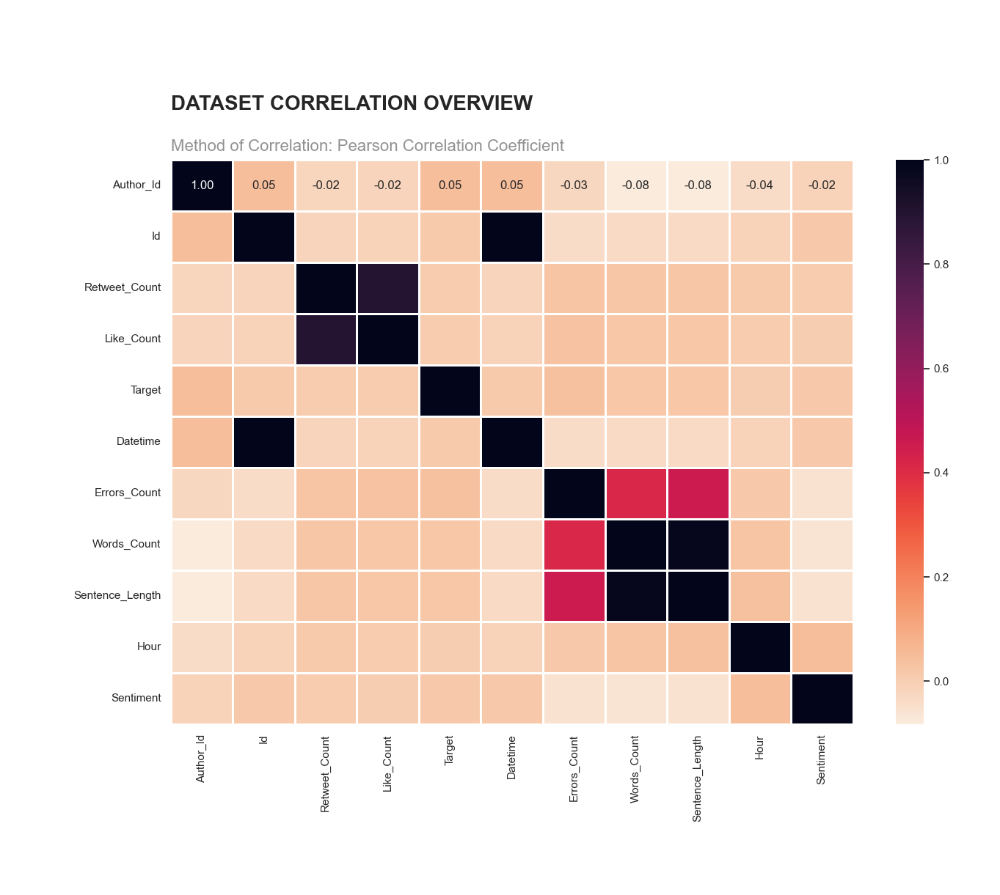

In [29]:
def plot_heatmap(data, cmap=sns.color_palette(palette='rocket_r', as_cmap=True), height=3, linewidth=1, title=' ', subtitle=' '):
    sns.set(style = 'whitegrid', rc = {'figure.figsize': (15,height)})

    g = sns.heatmap(data=data, cmap=cmap,
                    linewidths = linewidth,
                    annot=True,
                    fmt='.2f',
                    cbar_kws = dict(
                        location = 'right'))

    g.set_xlabel(' \n\n\n\n')
    g.set_ylabel(' \n\n\n\n')

    g.set_xticklabels([tick_label.get_text().title() for tick_label in g.get_xticklabels()])
    g.set_yticklabels([tick_label.get_text().title() for tick_label in g.get_yticklabels()])

    g.set_title(f'\n\n\n\n{title}\n\n'.upper(),
                loc = 'left',
                fontdict = dict(
                    fontsize = 20,
                    fontweight = 'bold'))

    plt.text(s=f'{subtitle}',
             alpha=0.5,
             x = 0,
             y = -0.4,
             horizontalalignment = 'left',
             verticalalignment = 'top',
             fontsize=16)

    plt.text(s = ' ',
             x = 1.2,
             y = 1,
             transform = g.transAxes)

    return g

plot_heatmap(
    height=10,
    # Remove columns 'year' and 'month' because it has only on value count
    data = data[data.describe().columns].drop(['year', 'month'], axis=1).corr(),
    title = 'Dataset Correlation Overview',
    subtitle = 'Method of Correlation: Pearson Correlation Coefficient'
);

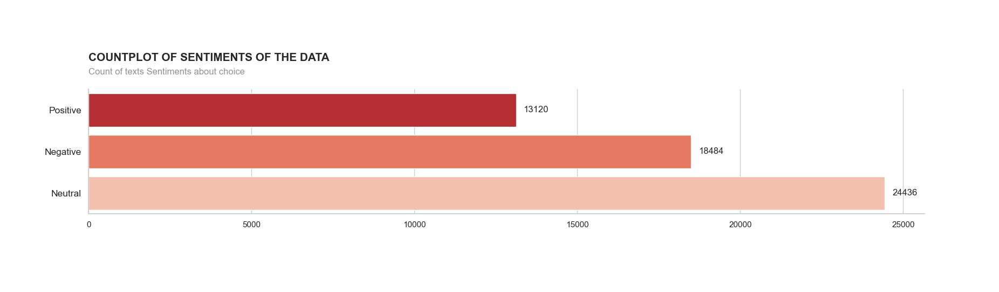

In [26]:
def plot_countplot(data=None, x=None, y=None, palette='Reds_r', height=15, title=' ', subtitle=' ', description=' '):
    sns.set(style = 'whitegrid',
            rc = {'figure.figsize': (20,height)})

    g = sns.countplot(data=data, y=y, x=x, palette=palette)

    g.set_ylabel(' \n\n\n')
    g.set_xlabel(' \n\n\n\n\n')

    g.set_title(
        f'\n\n\n\n{title}\n\n'.upper(),
        loc = 'left',
        fontdict = dict(
            fontsize = 15,
            fontweight = 'bold'))

    g.set_yticklabels(
        [tick_label.get_text().title() for tick_label in g.get_yticklabels()],
        fontdict = dict(
            fontsize = 12.5,
            fontweight = 'medium'))

    plt.text(s = f'{subtitle}',
             alpha = 0.5,
             x = 0,
             y = 1.12,
             horizontalalignment = 'left',
             transform = g.transAxes)

    plt.text(s = f'{description}',
             alpha = 0.5,
             x = 0,
             y = -.18,
             verticalalignment = 'baseline',
             horizontalalignment = 'left',
             transform = g.transAxes)

    g.bar_label(container = g.containers[0], padding = 10,)

    plt.text(s = ' ', x = 1.08, y = 1, transform = g.transAxes)

    sns.despine()

    return g

plot_countplot(y = data['overall_sentiment'],
               title = 'Countplot of Sentiments of the data',
               subtitle='Count of texts Sentiments about choice',
               height = 3);

In [30]:
# Helper Function to get the running average 
def get_weighted(series: pd.Series, beta=0.9):
    weighted = pd.Series(dtype=float)
    weighted[series.index[0]] = 0 
    for i in range(1, len(series)):
        current = series.iloc[i]
        previous = weighted.iloc[i-1]
        date = series.index[i]
        weighted[date] = beta*previous + (1-beta)*current
    return weighted 

# Get a two-line title for our plots
def get_multi_line_title(title:str, subtitle:str):
    return f"{title}<br><sub>{subtitle}</sub><br>"

In [31]:
title = get_multi_line_title(
    "Sentence Length of texts", 
    "Plotting the average number of Sentence Lengths for ceratin hour period of the day"
)

beta = 0.99 #higher value -> smoother curve

length = data.groupby('datetime')['sentence_length'].mean()
length_std = length.std()
length = length[length < 3*length_std]

weighted_length = get_weighted(length, beta)

fig = go.Figure([
    go.Scatter(
        name="Hourly Average Sentence Length",
        x=length.index, 
        y=length.values,
        mode="markers",
        opacity=0.3,
        marker_color="salmon"
    ), 
    go.Scatter(
        name="Weighted Average Sentence Length",
        x=weighted_length.index, 
        y=weighted_length.values,
        opacity=0.8,
        marker_color='crimson'
    ),
])

fig.update_layout(
    hovermode='x',
    title=title,
    xaxis_title="Time",
    yaxis_title="Average Sentence Length per text",
    template="ggplot2",
    legend_orientation = 'h'
)

fig.show()

In [32]:
title = get_multi_line_title(
    "Word Count of texts", 
    "Plotting the average number of Word Count for ceratin hour period of the day"
)

beta = 0.99 #higher value -> smoother curve

length = data.groupby('datetime')['words_count'].mean()
length_std = length.std()
length = length[length < 3*length_std]

weighted_length = get_weighted(length, beta)

fig = go.Figure([
    go.Scatter(
        name="Hourly Average Word Count",
        x=length.index, 
        y=length.values,
        mode="markers",
        opacity=0.3,
        marker_color="lightseagreen"
    ), 
    go.Scatter(
        name="Weighted Average Word Count",
        x=weighted_length.index, 
        y=weighted_length.values,
        opacity=0.8,
        marker_color='darkgreen'
    ),
])

fig.update_layout(
    hovermode='x',
    title=title,
    xaxis_title="Time",
    yaxis_title="Average Word Count per text",
    template="ggplot2",
    legend_orientation = 'h'
)

fig.show()

In [33]:
df_copy = data.copy()

title = get_multi_line_title("Sentence Length Distribution", "Distirbution of number of characters per text, by target")
data = df_copy[df_copy['text'].apply(len) != 0]
top_devices = data.groupby('target')['text'].count().sort_values(ascending=False)[:5].index.tolist()
data = data[data['target'].apply(lambda x: x in top_devices)]
fig = px.histogram(data, x="sentence_length", color="target", opacity=0.75)
fig.update_layout(hovermode='x', title=title)
fig.show()

In [34]:
title = get_multi_line_title(
    "Activity all over the day", 
    "Hourly activity basis ")

annual_counts = pd.DataFrame(df_copy['hour'].value_counts()).reset_index()
annual_counts.columns = ['hour', 'count']
annual_counts = annual_counts[annual_counts['hour'] != 2021]

fig = go.Figure(go.Bar(
    name="Annual Count", 
    x=annual_counts.hour, 
    y=annual_counts['count'], 
    marker_color=annual_counts['count'] 
))
fig.update_layout(template='ggplot2', title=title)
fig.show();

In [36]:
title = get_multi_line_title(
    'Sentiment Distribution',
    "What are the sentiments of Twitter Users about Prochoice vs Prolife?"
)

sentiment_pie = pd.DataFrame(df_copy['overall_sentiment'].value_counts() / df_copy.shape[0]*100).reset_index()
sentiment_pie.columns = ['Sentiment', 'Percentage']
fig = px.pie(sentiment_pie, values='Percentage', names='Sentiment', title=title)

fig.update_layout(
title=title, title_x=0.48)

fig.show()

In [37]:
sentiment_over_time = df_copy.sort_values('hour')[['hour', 'sentiment', 'overall_sentiment']]
annual_sentiment = pd.DataFrame(sentiment_over_time.groupby('hour')['overall_sentiment'].value_counts())
annual_sentiment.columns = ['Count']
annual_sentiment = annual_sentiment.reset_index()

title = get_multi_line_title('Hourly text Sentiment', "text Sentiments all over the day")
years = annual_sentiment.hour.unique().tolist()
sents = {'positive' : 'mediumseagreen', 'negative': 'crimson', 'neutral': 'royalblue'}

sentiment_bars = [] 
for s in sents.keys():
    current_year = annual_sentiment[annual_sentiment.overall_sentiment == s]
    sentiment_bars.append(
        go.Bar(name=s, x=current_year.hour, y=current_year.Count, marker_color = sents[s])
    )
    
    
fig = go.Figure(sentiment_bars)
fig.update_layout(template='ggplot2', title=title)
fig.show()

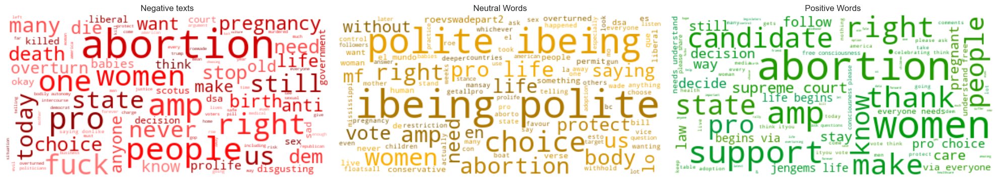

In [38]:
def flatten_list(l):
    return [x for y in l for x in y]

# color coding our wordclouds 
def red_color_func(word, font_size, position, orientation, random_state=None,**kwargs):
    return f"hsl(0, 100%, {random.randint(25, 75)}%)" 

def green_color_func(word, font_size, position, orientation, random_state=None,**kwargs):
    return f"hsl({random.randint(90, 150)}, 100%, 30%)" 

def yellow_color_func(word, font_size, position, orientation, random_state=None,**kwargs):
    return f"hsl(42, 100%, {random.randint(25, 50)}%)" 

def generate_word_clouds(neg_doc, neu_doc, pos_doc):
    # Display the generated image:
    fig, axes = plt.subplots(1,3, figsize=(20,10))
    wordcloud_neg = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(" ".join(neg_doc))
    axes[0].imshow(wordcloud_neg.recolor(color_func=red_color_func, random_state=3), interpolation='bilinear')
    axes[0].set_title("Negative texts")
    axes[0].axis("off")

    wordcloud_neu = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(" ".join(neu_doc))
    axes[1].imshow(wordcloud_neu.recolor(color_func=yellow_color_func, random_state=3), interpolation='bilinear')
    axes[1].set_title("Neutral Words")
    axes[1].axis("off")
    
    wordcloud_pos = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(" ".join(pos_doc))
    axes[2].imshow(wordcloud_pos.recolor(color_func=green_color_func, random_state=3), interpolation='bilinear')
    axes[2].set_title("Positive Words")
    axes[2].axis("off")

    plt.tight_layout()
    plt.show();

    
sentiment_sorted= data.sort_values('hour', ascending=False)
positive_top_100 = sentiment_sorted[sentiment_sorted['overall_sentiment'] == "positive"].iloc[:100]
negative_top_100 = sentiment_sorted[sentiment_sorted['overall_sentiment'] == "negative"].iloc[:100]
neutral_top_100 = sentiment_sorted[sentiment_sorted['overall_sentiment'] == "neutral"].iloc[:100]

cleanup = lambda x: [y for y in x.split() if y not in stopwords.words('english')]
neg_doc = flatten_list(negative_top_100['text'].apply(cleanup))
pos_doc = flatten_list(positive_top_100['text'].apply(cleanup))
neu_doc = flatten_list(neutral_top_100['text'].apply(cleanup))

generate_word_clouds(neg_doc, neu_doc, pos_doc)